In [10]:
from torch.utils.data import DataLoader, ConcatDataset
from torchvision.datasets import ImageFolder
import torchvision.transforms as T
import cv2
import os
import sys
import numpy as np


In [11]:
%cd ~/Documents/ProjetDL

/home/natsu/Documents/ProjetDL


In [3]:
i=0
size = (64,64)

for root, dirs, files in os.walk("./pokemon", topdown=False):
    for name in files:

        path= os.path.join(root, name)
        if (not("back" in path) and not("frame" in path)and not("female" in path)):
            image= cv2.imread(path,cv2.IMREAD_UNCHANGED)
            trans_mask = image[:,:,3] == 0

            #replace areas of transparency with white and not transparent
            image[trans_mask] = [255, 255, 255, 255]
            
            #new image without alpha channel...
            new_img = cv2.cvtColor(image, cv2.COLOR_BGRA2BGR)
            #Normal resizing
            i+=1
            resized = cv2.resize(image, size, interpolation = cv2.INTER_AREA )
            writePath="./augmentedData/pokemons/"+str(i)+".png"
            cv2.imwrite(writePath,resized)

            #Flipping
            flipped = cv2.flip(resized,1)
            i+=1
            writePath="./augmentedData/pokemons/"+str(i)+".png"
            cv2.imwrite(writePath,flipped)
        
print(i)

9800


In [12]:



IMAGE_DIR = "./augmentedData"
image_size = 64
batch_size = 32
normalization_stats = (0.5, 0.5, 0.5), (0.5, 0.5, 0.5) # Convert channels from [0, 1] to [-1, 1]

normal_dataset = ImageFolder(IMAGE_DIR, transform=T.Compose([
    T.Resize(image_size),
    T.CenterCrop(image_size),
    T.ToTensor(),
    T.Normalize(*normalization_stats)]))

color_jitter_dataset = ImageFolder(IMAGE_DIR, transform=T.Compose([
    T.Resize(image_size),
    T.CenterCrop(image_size),
    T.ColorJitter(0, 0.2, 1),
    T.ToTensor(),
    T.Normalize(*normalization_stats)]))

dataset_list = [normal_dataset, color_jitter_dataset]
dataset = ConcatDataset(dataset_list)


In [13]:
dataloader = DataLoader(dataset, batch_size, shuffle=True, num_workers=4, pin_memory=False)

In [14]:
def denorm(image):
    return image * normalization_stats[1][0] + normalization_stats[0][0]

In [15]:
import torch
from torchvision.utils import make_grid
import matplotlib.pyplot as plt
import torch.nn.utils as utils
%matplotlib inline

In [16]:


def show_images(images, nmax=64):
    fig, ax = plt.subplots(figsize=(8, 8))
    ax.set_xticks([]); ax.set_yticks([])
    ax.imshow(make_grid(denorm(images.detach()[:nmax]), nrow=8).permute(1, 2, 0))
    
def show_batch(dataloader, nmax=64):
    for images, _ in dataloader:
        show_images(images, nmax)
        break



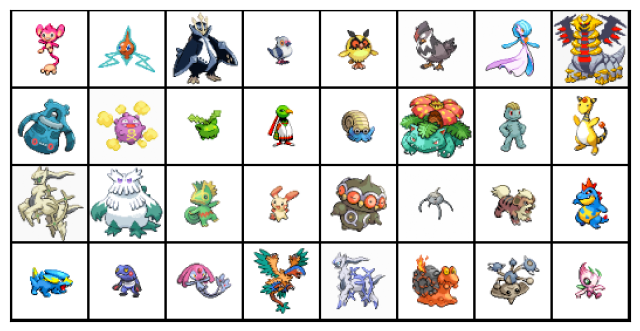

In [17]:
show_batch(dataloader)

In [18]:
import torch.nn as nn


In [19]:
disc_64_1 = nn.Sequential(
    # Input is 3 x 64 x 64
    nn.Conv2d(3, 32, kernel_size=4, stride=2, padding=1, bias=False),
    nn.LeakyReLU(0.2, inplace=True),
    # Layer Output: 32 x 32 x 32
    
    utils.spectral_norm(nn.Conv2d(32, 64, kernel_size=4, stride=2, padding=1, bias=False)),
    
    nn.LeakyReLU(0.2, inplace=True),
    # Layer Output: 64 x 16 x 16
    
    utils.spectral_norm(nn.Conv2d(64, 128, kernel_size=4, stride=2, padding=1, bias=False)),
    nn.LeakyReLU(0.2, inplace=True),
    # Layer Output: 128 x 8 x 8
    
    nn.Conv2d(128, 256, kernel_size=4, stride=2, padding=1, bias=False),
    nn.BatchNorm2d(256),
    nn.LeakyReLU(0.2, inplace=True),
    # Layer Output: 256 x 4 x 4
    
    # With a 4x4, we can condense the channels into a 1 x 1 x 1 to produce output
    nn.Conv2d(256, 1, kernel_size=4, stride=1, padding=0, bias=False),
    nn.Flatten(),
    nn.Sigmoid()
)

In [20]:
class Discriminator(nn.Module):
    def __init__(self):
        super(Discriminator, self).__init__()
        self.model = nn.Sequential(
            utils.spectral_norm(nn.Conv2d(3, 64, 4, 2, 1, bias=False)),  # 64x64 -> 32x32
            nn.LeakyReLU(0.2, inplace=True),

            utils.spectral_norm(nn.Conv2d(64, 128, 4, 2, 1, bias=False)),  # 32x32 -> 16x16
            nn.LeakyReLU(0.2, inplace=True),

            utils.spectral_norm(nn.Conv2d(128, 256, 4, 2, 1, bias=False)),  # 16x16 -> 8x8
            nn.LeakyReLU(0.2, inplace=True),

            utils.spectral_norm(nn.Conv2d(256, 512, 4, 2, 1, bias=False)),  # 8x8 -> 4x4
            nn.LeakyReLU(0.2, inplace=True),

            nn.Conv2d(512,1,kernel_size=4,stride=1,padding=0,bias=False),
            nn.Flatten(),
            nn.Sigmoid()
        )

    def forward(self, x):
        x = self.model(x) # Pass image through the model
        return x  # Flattn output for loss computation
#isc_64_1 = Discriminator()

In [21]:
seed_size = 256

In [22]:
gen_64_2 = nn.Sequential(
    # Input seed_size x 1 x 1
    nn.ConvTranspose2d(seed_size, 128, kernel_size=4, padding=0, stride=1, bias=False),
    nn.BatchNorm2d(128),
    nn.ReLU(True),
    nn.Dropout(),
    # Layer output: 128 x 4 x 4
    
    nn.ConvTranspose2d(128, 128, kernel_size=4, padding=1, stride=2, bias=False),
    nn.BatchNorm2d(128),
    nn.ReLU(True),
    # Layer output: 128 x 8 x 8
    
    nn.ConvTranspose2d(128, 128, kernel_size=4, padding=1, stride=2, bias=False),
    nn.BatchNorm2d(128),
    nn.ReLU(True),
    # Layer output: 64 x 16 x 16
    
    nn.ConvTranspose2d(128, 64, kernel_size=4, padding=1, stride=2, bias=False),
    nn.BatchNorm2d(64),
    nn.ReLU(True),
    # Layer output: 32 x 32 x 32
    
    nn.ConvTranspose2d(64, 3, kernel_size=4, padding=1, stride=2, bias=False),
    nn.Tanh()
    # Output: 3 x 64 x 64
)

In [23]:
import torch
import torch.nn as nn
gen_64_3= nn.Sequential(
    nn.ConvTranspose2d(seed_size, 512, 4, 1, 0, bias=False),  # 4x4
    nn.BatchNorm2d(512),
    nn.ReLU(True),

    nn.ConvTranspose2d(512, 256, 4, 2, 1, bias=False),  # 8x8
    nn.BatchNorm2d(256),
    nn.ReLU(True),

    nn.ConvTranspose2d(256, 128, 4, 2, 1, bias=False),  # 16x16
    nn.BatchNorm2d(128),
    nn.ReLU(True),

    nn.ConvTranspose2d(128, 64, 4, 2, 1, bias=False),  # 32x32
    nn.BatchNorm2d(64),
    nn.ReLU(True),

    nn.ConvTranspose2d(64, 3, 4, 2, 1, bias=False),  # 64x64
    nn.Tanh()
)

In [24]:
class Generator(nn.Module):
    def __init__(self, seed_size):
        super().__init__()
        self.model = nn.Sequential(
            nn.ConvTranspose2d(seed_size, 1024, 4, 1, 0, bias=False),  # More features here
            nn.BatchNorm2d(1024),
            nn.ReLU(True),

            nn.ConvTranspose2d(1024, 512, 4, 2, 1, bias=False),  # Wider layers
            nn.BatchNorm2d(512),
            nn.ReLU(True),

            nn.ConvTranspose2d(512, 256, 4, 2, 1, bias=False),
            nn.BatchNorm2d(256),
            nn.ReLU(True),

            nn.ConvTranspose2d(256, 128, 4, 2, 1, bias=False),
            nn.BatchNorm2d(128),
            nn.ReLU(True),

            nn.ConvTranspose2d(128, 3, 4, 2, 1, bias=False),
            nn.Tanh()
        )

    def forward(self, z):
        noise = torch.randn_like(z) * 0.1  # Inject small noise
        z = z + noise
        return self.model(z.view(z.size(0), -1, 1, 1))

In [25]:
class Generator(nn.Module):
    def __init__(self,nz):
        super(Generator, self).__init__()
        ngf=32
        nc=3
        self.model = nn.Sequential(
            # input is Z, going into a convolution
            
            nn.ConvTranspose2d( nz, ngf * 8, 4, 1, 0, bias=False),
            nn.BatchNorm2d(ngf * 8),
            nn.ReLU(True),
            # state size. ``(ngf*8) x 4 x 4``
            nn.ConvTranspose2d(ngf * 8, ngf * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf * 4),
            nn.ReLU(True),
            # state size. ``(ngf*4) x 8 x 8``
            nn.ConvTranspose2d( ngf * 4, ngf * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf * 2),
            nn.ReLU(True),
            # state size. ``(ngf*2) x 16 x 16``
            nn.ConvTranspose2d( ngf * 2, ngf, 4, 2, 1, bias=False),
            nn.Tanh()
            # state size. ``(nc) x 64 x 64``
        )

    def forward(self, z):
        noise = torch.randn_like(z) * 0.1  # Inject small noise
        z = z + noise
        return self.model(z)

In [26]:
#gen_64_3 = Generator(seed_size)

In [27]:


test_model_size = False

if test_model_size:
    # Make some latent tensors to seed the generator
    seed_batch = torch.randn(batch_size, seed_size, 1, 1, device=device)

    # Get some fake pokemon
    generator=gen_64_1
    to_device(generator, device)
    fake_pokemon = generator(seed_batch)
    print(fake_pokemon.size())



In [28]:
def get_training_device():
    # Use the GPU if possible
    if torch.cuda.is_available():
        return torch.device('cuda')
    # Otherwise use the CPU :-(
    return torch.device('cpu')

def to_device(data, device):
    # This moves the tensors to the device (GPU, CPU)
    if isinstance(data, (list,tuple)):
        return [to_device(x, device) for x in data]
    return data.to(device, non_blocking=True)

class DeviceDataLoader():
    """Wrap a dataloader to move data to a device"""
    def __init__(self, dataloader, device):
        self.dataloader = dataloader
        self.device = device
        
    def __iter__(self):
        """Yield a batch of data after moving it to device"""
        for b in self.dataloader: 
            yield to_device(b, self.device)

    def __len__(self):
        """Number of batches"""
        return len(self.dataloader)

In [29]:
device = get_training_device()
device



device(type='cuda')

In [30]:
dev_dataloader = DeviceDataLoader(dataloader, device)

In [31]:
def train_discriminator(real_pokemon, disc_optimizer):
    # Reset the gradients for the optimizer
    disc_optimizer.zero_grad()

    # Création d'une seed pour le générateur
    latent_batch = torch.randn(batch_size, seed_size, 1, 1, device=device)
    
    # Generation de faux pokemons
    fake_pokemon = generator(latent_batch)
    
    # Prédictions du discriminateur
    real_predictions = discriminator(real_pokemon)
    gen_predictions = discriminator(fake_pokemon)

    #Choix de la loss
    #choice='cross_entropy'
    choice='wgan'
    # real_targets = torch.zeros(real_pokemon.size(0), 1, device=device) # All of these are real, so the target is 0.
    if choice=='cross_entropy':
        real_targets = torch.rand(real_pokemon.size(0), 1, device=device) * (0.1 - 0) + 0 # Add some noisy labels to make the discriminator think harder.
        real_loss = F.binary_cross_entropy(real_predictions, real_targets) # Can do binary loss function because it is a binary classifier
        # Train on the generator's current efforts to trick the discriminator
        
        # gen_targets = torch.ones(fake_pokemon.size(0), 1, device=device)
        gen_targets = torch.rand(fake_pokemon.size(0), 1, device=device) * (1 - 0.9) + 0.9 # Add some noisy labels to make the discriminator think harder.
        gen_loss = F.binary_cross_entropy(gen_predictions, gen_targets)
       
    elif choice=='wgan':
        #real_targets= torch.zeros(real_pokemon.size(0), device=device)
        real_targets = torch.rand(real_pokemon.size(0), 1, device=device) * (0.1 - 0) + 0
        gen_predictions2=torch.flatten(gen_predictions)
        real_predictions2=torch.flatten(real_predictions)
        print(real_predictions)
        real_loss = gen_predictions2.mean()-real_predictions2.mean()
        
        #gen_targets = torch.ones(fake_pokemon.size(0), device=device) 
        gen_targets=torch.rand(fake_pokemon.size(0), 1, device=device) * (1 - 0.9) + 0.9 
        gen_loss = gen_predictions2.mean()-real_predictions2.mean()
        print(gen_predictions)
    real_score = torch.mean(real_predictions).item() # How well does the discriminator classify the real pokemon? (Higher score is better for the discriminator)
    gen_score = torch.mean(gen_predictions).item() # How well did the discriminator classify the fake pokemon? (Lower score is better for the discriminator)
    # Update the discriminator weights
    total_loss = real_loss + gen_loss
    total_loss.backward()
    disc_optimizer.step()
    return total_loss.item(), real_score, gen_score

In [32]:
def train_generator(gen_optimizer):
    # Clear the generator gradients
    gen_optimizer.zero_grad()
    
    # Generate some fake pokemon
    latent_batch = torch.randn(batch_size, seed_size, 1, 1, device=device)
    fake_pokemon = generator(latent_batch)
    
    # Test against the discriminator
    disc_predictions = discriminator(fake_pokemon)
    targets = torch.zeros(fake_pokemon.size(0), 1, device=device) # We want the discriminator to think these images are real.
    
    #Choix de la loss
    #choice='cross_entropy'
    choice='wgan'

    if choice=='cross_entropy':
        loss = F.binary_cross_entropy(disc_predictions, targets) # How well did the generator do? (How much did the discriminator believe the generator?)
    elif choice=='wgan':
        loss = -disc_predictions.mean()
        print(loss.item())
    # Update the generator based on how well it fooled the discriminator
    loss.backward()
    gen_optimizer.step()
    
    # Return generator loss
    return loss.item()

In [33]:


import os
from torchvision.utils import save_image

RESULTS_DIR = 'results'
os.makedirs(RESULTS_DIR, exist_ok=True)



In [34]:
def save_results(index, latent_batch, show=True):
    # Generate fake pokemon
    fake_pokemon = generator(latent_batch)
    
    # Make the filename for the output
    fake_file = "result-image-{0:0=4d}.png".format(index)
    
    # Save the image
    save_image(denorm(fake_pokemon), os.path.join(RESULTS_DIR, fake_file), nrow=8)
    print("Result Saved!")
    
    if show:
        fig, ax = plt.subplots(figsize=(8, 8))
        ax.set_xticks([]); ax.set_yticks([])
        ax.imshow(make_grid(fake_pokemon.cpu().detach(), nrow=8).permute(1, 2, 0))

In [35]:
from tqdm.notebook import tqdm
import torch.nn.functional as F

# Static generation seed batch
fixed_latent_batch = torch.randn(64, seed_size, 1, 1, device=device)

def train(epochs, learning_rate, start_idx=1):
    # Empty the GPU cache to save some memory
    torch.cuda.empty_cache()
    
    # Track losses and scores
    disc_losses = []
    disc_scores = []
    gen_losses = []
    gen_scores = []
    
    # Create the optimizers
    disc_optimizer = torch.optim.Adam(discriminator.parameters(), lr=learning_rate, betas=(0.5, 0.9))
    gen_optimizer = torch.optim.Adam(generator.parameters(), lr=learning_rate, betas=(0.5, 0.9))
    
    # Run the loop
    for epoch in range(epochs):
        # Go through each image
        for real_img, _ in tqdm(dev_dataloader):
            # Train the discriminator
            disc_loss, real_score, gen_score = train_discriminator(real_img, disc_optimizer)

            # Train the generator
            gen_loss = train_generator(gen_optimizer)
        
        # Collect results
        disc_losses.append(disc_loss)
        disc_scores.append(real_score)
        gen_losses.append(gen_loss)
        gen_scores.append(gen_score)
        
        # Print the losses and scores
        print("Epoch [{}/{}], gen_loss: {:.4f}, disc_loss: {:.4f}, real_score: {:.4f}, gen_score: {:.4f}".format(
            epoch+start_idx, epochs, gen_loss, disc_loss, real_score, gen_score))
        
        # Save the images and show the progress
        save_results(epoch + start_idx, fixed_latent_batch, show=False)
    
    # Return stats
    return disc_losses, disc_scores, gen_losses, gen_scores

In [36]:
def debug_memory():
    import collections, gc, resource, torch
    print('maxrss = {}'.format(
        resource.getrusage(resource.RUSAGE_SELF).ru_maxrss))
    tensors = collections.Counter((str(o.device), o.dtype, tuple(o.shape))
                                  for o in gc.get_objects()
                                  if torch.is_tensor(o))
    for line in tensors.items():
        print('{}\t{}'.format(*line))

In [37]:


mem_debug = False
if mem_debug:
    debug_memory()



In [38]:
# Clean up everything
cleanup = False
if cleanup:
    import gc
    del dev_dataloader
    del discriminator
    del generator
    dev_dataloader = None
    discriminator = None
    generator = None
    gc.collect()
    torch.cuda.empty_cache()

In [39]:


# Re-initialize the device dataloader
dev_dataloader = DeviceDataLoader(dataloader, device)



In [40]:
discriminator = disc_64_1

# Send to device
discriminator = to_device(discriminator, device)

In [41]:


# Generators
# generator = gen_1
# generator = gen_3
# generator = gen_5

# 64 x 64 Generators
# generator = gen_64_1
generator = gen_64_2
#generator=Generator(32)
# Send to device
generator = to_device(generator, device)



In [44]:
# learning_rate = 0.0025 # worked fairly well for disc/gen_64_1
learning_rate = 0.00105
learning_rate = 0.01105
epochs = 130

In [ ]:


history = train(epochs, learning_rate)



  0%|          | 0/613 [00:00<?, ?it/s]

tensor([[1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.]], device='cuda:0', grad_fn=<SigmoidBackward0>)
tensor([[1.4141e-12],
        [6.2940e-13],
        [2.5250e-12],
        [1.9477e-12],
        [2.4148e-12],
        [4.0515e-12],
        [9.4709e-13],
        [1.9689e-12],
        [1.7634e-12],
        [5.3093e-12],
        [1.0395e-12],
        [2.0331e-12],
        [2.2574e-12],
        [2.4160e-12],
        [4.1714e-12],
        [6.0874e-12],
        [2.8343e-12],
        [2.4716e-12],
        [1.4559e-12],
        [1.5855e-12],
        [1.3872e-12],
        [1.0075e-12],
        [1.5340e-12],


  0%|          | 0/613 [00:00<?, ?it/s]

tensor([[1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.]], device='cuda:0', grad_fn=<SigmoidBackward0>)
tensor([[1.5513e-13],
        [1.5277e-13],
        [1.3173e-13],
        [1.1443e-13],
        [2.8620e-13],
        [1.7747e-13],
        [8.6010e-13],
        [2.3102e-13],
        [1.3562e-13],
        [2.0678e-13],
        [4.4102e-13],
        [4.0922e-13],
        [1.9603e-13],
        [7.2911e-13],
        [3.6504e-13],
        [9.1790e-14],
        [8.7016e-14],
        [4.0021e-13],
        [3.7343e-13],
        [1.9534e-12],
        [1.0448e-13],
        [2.2017e-13],
        [4.7832e-14],


  0%|          | 0/613 [00:00<?, ?it/s]

tensor([[1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.]], device='cuda:0', grad_fn=<SigmoidBackward0>)
tensor([[8.0534e-14],
        [1.1356e-13],
        [6.1163e-14],
        [3.5745e-14],
        [8.3391e-14],
        [5.5695e-14],
        [2.3781e-13],
        [4.3160e-14],
        [2.9906e-13],
        [4.6757e-13],
        [1.7080e-13],
        [7.5693e-14],
        [8.8818e-14],
        [2.2840e-13],
        [1.1211e-13],
        [7.5734e-14],
        [1.5315e-13],
        [8.8026e-14],
        [4.3492e-14],
        [2.2101e-13],
        [5.4823e-14],
        [3.4956e-13],
        [5.7261e-14],


  0%|          | 0/613 [00:00<?, ?it/s]

tensor([[1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.]], device='cuda:0', grad_fn=<SigmoidBackward0>)
tensor([[4.6912e-13],
        [2.7976e-14],
        [1.2740e-13],
        [4.2679e-14],
        [2.8560e-14],
        [1.4998e-13],
        [9.5509e-14],
        [5.7117e-14],
        [6.7070e-14],
        [4.3508e-14],
        [4.5790e-14],
        [3.3538e-14],
        [5.1687e-14],
        [2.1502e-13],
        [6.1132e-14],
        [5.3047e-14],
        [1.3676e-13],
        [2.0043e-13],
        [5.7738e-14],
        [1.8269e-13],
        [3.3693e-13],
        [4.8041e-14],
        [4.0739e-14],


  0%|          | 0/613 [00:00<?, ?it/s]

tensor([[1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.]], device='cuda:0', grad_fn=<SigmoidBackward0>)
tensor([[4.1009e-14],
        [1.8562e-14],
        [4.4119e-14],
        [3.5669e-14],
        [2.4668e-14],
        [3.2770e-14],
        [6.0980e-14],
        [2.3023e-13],
        [8.5025e-14],
        [2.0655e-14],
        [2.6234e-14],
        [3.0152e-14],
        [6.2559e-14],
        [6.6450e-14],
        [1.0294e-13],
        [8.7562e-14],
        [2.4912e-14],
        [5.7185e-14],
        [4.7114e-14],
        [2.7907e-14],
        [3.1166e-14],
        [7.5619e-14],
        [1.4686e-13],


  0%|          | 0/613 [00:00<?, ?it/s]

tensor([[1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.]], device='cuda:0', grad_fn=<SigmoidBackward0>)
tensor([[4.0478e-14],
        [4.9873e-14],
        [2.5549e-14],
        [4.5221e-14],
        [1.4276e-14],
        [1.1227e-13],
        [3.1246e-14],
        [2.3002e-14],
        [8.1152e-14],
        [1.2028e-13],
        [1.1049e-13],
        [4.6442e-14],
        [4.0556e-14],
        [6.9341e-14],
        [3.1620e-14],
        [8.9796e-14],
        [7.2065e-14],
        [8.2705e-15],
        [3.4737e-14],
        [4.2598e-14],
        [7.6237e-14],
        [2.8593e-14],
        [3.1296e-14],


  0%|          | 0/613 [00:00<?, ?it/s]

tensor([[1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.]], device='cuda:0', grad_fn=<SigmoidBackward0>)
tensor([[3.1047e-14],
        [4.9222e-14],
        [3.6630e-14],
        [4.8391e-14],
        [2.7268e-14],
        [2.2891e-14],
        [4.4530e-14],
        [2.3758e-14],
        [2.9147e-14],
        [6.2470e-14],
        [1.9360e-13],
        [5.5167e-14],
        [4.2186e-14],
        [2.2526e-14],
        [3.6847e-14],
        [4.5791e-14],
        [9.9641e-15],
        [5.8115e-14],
        [3.4396e-14],
        [1.2164e-14],
        [4.2990e-14],
        [3.6144e-14],
        [1.9504e-14],


  0%|          | 0/613 [00:00<?, ?it/s]

tensor([[1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.]], device='cuda:0', grad_fn=<SigmoidBackward0>)
tensor([[7.3476e-14],
        [1.5043e-14],
        [1.0721e-14],
        [2.8754e-14],
        [3.7037e-14],
        [1.1919e-14],
        [4.7810e-14],
        [3.1265e-14],
        [2.8850e-14],
        [4.4394e-14],
        [1.3517e-14],
        [2.7554e-14],
        [2.9014e-14],
        [2.2775e-14],
        [3.6990e-14],
        [1.6863e-14],
        [1.9045e-14],
        [5.9830e-14],
        [2.6825e-14],
        [4.4840e-14],
        [8.2009e-14],
        [4.3722e-14],
        [2.4212e-14],


  0%|          | 0/613 [00:00<?, ?it/s]

tensor([[1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.]], device='cuda:0', grad_fn=<SigmoidBackward0>)
tensor([[6.3804e-14],
        [1.5271e-14],
        [1.5635e-14],
        [3.7569e-14],
        [1.4449e-14],
        [2.5472e-14],
        [1.9726e-14],
        [1.0013e-13],
        [2.7845e-13],
        [2.4562e-14],
        [1.7367e-14],
        [1.1456e-13],
        [5.8631e-14],
        [1.7991e-14],
        [1.8196e-14],
        [7.8645e-14],
        [3.3673e-14],
        [5.2591e-13],
        [2.1770e-14],
        [1.5481e-14],
        [3.3518e-14],
        [2.5802e-14],
        [1.4286e-14],


  0%|          | 0/613 [00:00<?, ?it/s]

tensor([[1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.]], device='cuda:0', grad_fn=<SigmoidBackward0>)
tensor([[4.8452e-14],
        [3.5543e-14],
        [1.9523e-14],
        [3.0434e-14],
        [1.0888e-14],
        [4.3321e-14],
        [2.0204e-14],
        [3.9456e-14],
        [2.0176e-14],
        [2.1334e-14],
        [5.0606e-14],
        [1.2717e-14],
        [1.4757e-14],
        [1.0193e-14],
        [2.3611e-14],
        [1.2584e-14],
        [1.7317e-14],
        [2.8235e-14],
        [1.8351e-14],
        [1.1064e-14],
        [1.7775e-14],
        [2.2729e-14],
        [7.0335e-14],


  0%|          | 0/613 [00:00<?, ?it/s]

tensor([[1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.]], device='cuda:0', grad_fn=<SigmoidBackward0>)
tensor([[3.9430e-14],
        [1.4788e-14],
        [2.5261e-14],
        [1.8708e-14],
        [1.4097e-14],
        [1.2256e-14],
        [1.6219e-14],
        [4.0332e-14],
        [1.5780e-14],
        [7.7230e-15],
        [1.9687e-14],
        [1.7213e-14],
        [1.2266e-14],
        [1.7670e-14],
        [7.5216e-14],
        [9.6953e-15],
        [1.8559e-14],
        [2.1924e-14],
        [1.1619e-14],
        [1.9043e-14],
        [1.0891e-13],
        [4.1852e-14],
        [5.2299e-14],


  0%|          | 0/613 [00:00<?, ?it/s]

tensor([[1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.]], device='cuda:0', grad_fn=<SigmoidBackward0>)
tensor([[1.4004e-14],
        [4.3425e-14],
        [7.4573e-15],
        [1.0155e-14],
        [1.6744e-14],
        [1.1337e-14],
        [2.8516e-14],
        [1.0587e-14],
        [1.5266e-14],
        [7.3324e-14],
        [6.3873e-14],
        [1.0374e-14],
        [1.6766e-14],
        [9.0132e-15],
        [5.2735e-14],
        [3.3371e-14],
        [1.3403e-14],
        [1.6788e-14],
        [8.0700e-15],
        [1.3202e-14],
        [1.3844e-14],
        [1.6552e-14],
        [1.7961e-14],


  0%|          | 0/613 [00:00<?, ?it/s]

tensor([[1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.]], device='cuda:0', grad_fn=<SigmoidBackward0>)
tensor([[1.6755e-14],
        [7.3356e-15],
        [2.8484e-14],
        [9.4478e-15],
        [2.5765e-14],
        [1.2448e-14],
        [1.7057e-14],
        [9.6159e-15],
        [3.3332e-14],
        [3.5545e-14],
        [2.1442e-14],
        [1.4330e-14],
        [1.5729e-14],
        [1.3684e-14],
        [1.2366e-14],
        [7.4231e-15],
        [8.5811e-15],
        [2.2862e-14],
        [3.7733e-14],
        [2.7564e-14],
        [1.7482e-14],
        [1.3311e-14],
        [4.0661e-14],


  0%|          | 0/613 [00:00<?, ?it/s]

tensor([[1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.]], device='cuda:0', grad_fn=<SigmoidBackward0>)
tensor([[2.2365e-14],
        [1.4989e-14],
        [1.1524e-14],
        [1.9303e-14],
        [1.0627e-14],
        [1.7124e-14],
        [9.2283e-15],
        [1.2594e-14],
        [3.2795e-14],
        [1.8145e-14],
        [2.3118e-14],
        [3.1912e-14],
        [1.0212e-14],
        [1.6237e-14],
        [1.5746e-14],
        [2.5360e-14],
        [1.9568e-14],
        [4.7149e-14],
        [8.3721e-15],
        [4.3913e-15],
        [1.4434e-14],
        [1.9434e-14],
        [7.3573e-15],


  0%|          | 0/613 [00:00<?, ?it/s]

tensor([[1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.]], device='cuda:0', grad_fn=<SigmoidBackward0>)
tensor([[1.2355e-14],
        [2.5112e-14],
        [3.5796e-13],
        [1.1920e-14],
        [6.7871e-15],
        [2.0870e-14],
        [1.1387e-14],
        [1.2813e-14],
        [6.1057e-15],
        [1.1982e-14],
        [1.1292e-14],
        [4.9663e-14],
        [2.5563e-14],
        [1.1553e-14],
        [7.9820e-15],
        [4.8394e-15],
        [2.3263e-14],
        [2.8628e-14],
        [9.7527e-15],
        [9.2644e-15],
        [1.7290e-14],
        [1.6924e-14],
        [7.8176e-15],


  0%|          | 0/613 [00:00<?, ?it/s]

tensor([[1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.]], device='cuda:0', grad_fn=<SigmoidBackward0>)
tensor([[5.4486e-15],
        [1.9220e-14],
        [1.0702e-14],
        [1.4451e-14],
        [9.8995e-15],
        [1.1029e-13],
        [1.4837e-14],
        [7.1188e-14],
        [2.6968e-14],
        [1.3269e-14],
        [1.2954e-14],
        [5.4455e-14],
        [1.1863e-14],
        [1.4357e-14],
        [1.3241e-14],
        [1.4893e-14],
        [2.4369e-14],
        [2.2366e-14],
        [2.2542e-14],
        [7.5594e-15],
        [1.1636e-14],
        [1.1206e-14],
        [7.3979e-15],


  0%|          | 0/613 [00:00<?, ?it/s]

tensor([[1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.]], device='cuda:0', grad_fn=<SigmoidBackward0>)
tensor([[6.9673e-15],
        [2.7657e-14],
        [7.9239e-15],
        [2.2295e-14],
        [3.3569e-14],
        [4.0581e-14],
        [5.7473e-15],
        [5.2654e-15],
        [2.3381e-14],
        [1.0506e-13],
        [1.7526e-14],
        [7.3287e-14],
        [4.8047e-13],
        [2.3420e-14],
        [7.5002e-15],
        [1.1606e-14],
        [1.0002e-14],
        [5.3608e-15],
        [1.0678e-14],
        [1.3016e-14],
        [2.8117e-14],
        [2.9071e-14],
        [2.2034e-14],


  0%|          | 0/613 [00:00<?, ?it/s]

tensor([[1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.]], device='cuda:0', grad_fn=<SigmoidBackward0>)
tensor([[1.9709e-14],
        [1.5726e-14],
        [9.7444e-15],
        [5.6806e-15],
        [9.8997e-15],
        [1.6849e-14],
        [1.1354e-14],
        [3.8783e-15],
        [1.8534e-14],
        [1.5836e-14],
        [1.4836e-14],
        [2.5094e-14],
        [1.5520e-14],
        [1.7831e-14],
        [7.5543e-15],
        [1.4190e-14],
        [1.8650e-14],
        [1.8593e-14],
        [1.2015e-14],
        [1.3669e-14],
        [4.5014e-15],
        [6.6256e-15],
        [5.1285e-15],


  0%|          | 0/613 [00:00<?, ?it/s]

tensor([[1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.]], device='cuda:0', grad_fn=<SigmoidBackward0>)
tensor([[2.9698e-14],
        [2.3150e-14],
        [4.3432e-15],
        [1.8832e-14],
        [2.0735e-14],
        [4.6734e-15],
        [1.1842e-14],
        [6.0772e-15],
        [4.0475e-14],
        [6.0669e-15],
        [6.7532e-15],
        [6.4654e-15],
        [3.3767e-14],
        [1.9946e-14],
        [8.1375e-15],
        [8.3438e-15],
        [1.0875e-14],
        [6.5228e-15],
        [9.9378e-15],
        [1.2238e-14],
        [2.1187e-14],
        [1.0351e-14],
        [1.4500e-14],


  0%|          | 0/613 [00:00<?, ?it/s]

tensor([[1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.]], device='cuda:0', grad_fn=<SigmoidBackward0>)
tensor([[3.7107e-14],
        [5.9062e-15],
        [3.9034e-14],
        [7.8754e-15],
        [4.7154e-15],
        [4.3008e-15],
        [9.5768e-15],
        [1.3999e-14],
        [6.5708e-15],
        [6.5088e-15],
        [3.4808e-15],
        [3.0326e-14],
        [1.5903e-14],
        [1.1164e-14],
        [1.2261e-14],
        [1.7088e-14],
        [1.2706e-14],
        [7.5309e-15],
        [6.5207e-15],
        [2.0743e-14],
        [9.5770e-15],
        [1.3401e-14],
        [6.0653e-15],


  0%|          | 0/613 [00:00<?, ?it/s]

tensor([[1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.]], device='cuda:0', grad_fn=<SigmoidBackward0>)
tensor([[5.2465e-14],
        [4.4759e-14],
        [1.1728e-14],
        [7.1971e-15],
        [8.9009e-15],
        [1.9834e-14],
        [6.4836e-15],
        [6.1652e-15],
        [1.1145e-14],
        [1.3529e-14],
        [1.6932e-14],
        [9.1331e-15],
        [8.0223e-15],
        [4.9537e-15],
        [6.8234e-15],
        [9.0393e-15],
        [7.8352e-15],
        [6.1265e-15],
        [6.9279e-15],
        [8.9607e-15],
        [7.8610e-15],
        [8.9551e-15],
        [1.9901e-14],


  0%|          | 0/613 [00:00<?, ?it/s]

tensor([[1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.]], device='cuda:0', grad_fn=<SigmoidBackward0>)
tensor([[6.4918e-15],
        [1.0970e-14],
        [1.0152e-14],
        [4.0110e-15],
        [1.0055e-14],
        [5.7133e-15],
        [2.1605e-14],
        [3.9434e-15],
        [3.5405e-14],
        [8.1934e-15],
        [1.6937e-14],
        [1.9009e-14],
        [3.4397e-14],
        [7.0837e-15],
        [1.7968e-14],
        [1.6493e-14],
        [2.3772e-14],
        [4.8446e-15],
        [1.1152e-14],
        [5.4383e-14],
        [7.2900e-15],
        [8.1078e-15],
        [1.1872e-14],


  0%|          | 0/613 [00:00<?, ?it/s]

tensor([[1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.]], device='cuda:0', grad_fn=<SigmoidBackward0>)
tensor([[1.0539e-14],
        [1.8347e-14],
        [8.0936e-15],
        [1.8463e-14],
        [6.9957e-15],
        [1.3152e-14],
        [8.7354e-15],
        [5.9112e-15],
        [7.8000e-15],
        [3.4767e-15],
        [1.2897e-14],
        [9.5789e-15],
        [1.0457e-14],
        [4.9789e-15],
        [1.9202e-14],
        [8.4653e-15],
        [7.0966e-15],
        [1.5204e-14],
        [5.4094e-15],
        [4.9270e-15],
        [3.1286e-14],
        [2.2106e-14],
        [4.7966e-15],


  0%|          | 0/613 [00:00<?, ?it/s]

tensor([[1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.]], device='cuda:0', grad_fn=<SigmoidBackward0>)
tensor([[3.3098e-15],
        [5.3479e-15],
        [1.3024e-14],
        [4.6970e-13],
        [1.4907e-14],
        [2.0993e-14],
        [6.4019e-15],
        [8.7100e-15],
        [1.2992e-14],
        [6.7273e-15],
        [9.7864e-15],
        [2.3532e-14],
        [9.0535e-15],
        [7.1891e-15],
        [2.3614e-14],
        [4.1766e-15],
        [1.5439e-14],
        [1.6298e-14],
        [3.4448e-14],
        [1.8242e-14],
        [5.1668e-15],
        [4.2211e-15],
        [8.6908e-15],


  0%|          | 0/613 [00:00<?, ?it/s]

tensor([[1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.]], device='cuda:0', grad_fn=<SigmoidBackward0>)
tensor([[1.3135e-14],
        [8.9789e-15],
        [1.3623e-14],
        [1.5021e-14],
        [1.6530e-14],
        [1.3066e-14],
        [7.7393e-15],
        [1.1187e-14],
        [1.2624e-14],
        [9.5648e-15],
        [4.0628e-14],
        [8.0764e-15],
        [1.7440e-14],
        [4.5024e-15],
        [3.1936e-15],
        [4.1574e-15],
        [1.8432e-14],
        [9.9667e-15],
        [2.8537e-15],
        [5.5467e-15],
        [1.0663e-14],
        [3.3258e-15],
        [5.0986e-15],


  0%|          | 0/613 [00:00<?, ?it/s]

tensor([[1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.]], device='cuda:0', grad_fn=<SigmoidBackward0>)
tensor([[5.8418e-15],
        [1.1807e-14],
        [8.2214e-15],
        [1.6812e-14],
        [1.8952e-14],
        [1.2107e-14],
        [1.0490e-14],
        [3.9487e-15],
        [5.4453e-15],
        [5.3193e-15],
        [4.8514e-15],
        [2.3493e-14],
        [5.0166e-15],
        [4.3589e-15],
        [7.6248e-15],
        [4.1826e-15],
        [2.2503e-14],
        [6.0130e-15],
        [8.1759e-15],
        [7.8755e-15],
        [1.1423e-14],
        [2.3568e-15],
        [8.5376e-15],


  0%|          | 0/613 [00:00<?, ?it/s]

tensor([[1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.]], device='cuda:0', grad_fn=<SigmoidBackward0>)
tensor([[7.2811e-15],
        [9.2781e-15],
        [5.2671e-15],
        [6.6183e-15],
        [1.1348e-14],
        [7.4395e-15],
        [6.8255e-15],
        [1.1604e-14],
        [3.7298e-14],
        [2.5606e-14],
        [3.0158e-15],
        [3.2369e-14],
        [2.1138e-15],
        [3.8243e-15],
        [1.4102e-14],
        [7.7774e-15],
        [4.0589e-15],
        [2.4895e-14],
        [3.7307e-14],
        [5.9777e-15],
        [1.0413e-14],
        [6.0585e-15],
        [1.7061e-14],


  0%|          | 0/613 [00:00<?, ?it/s]

tensor([[1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.]], device='cuda:0', grad_fn=<SigmoidBackward0>)
tensor([[2.5039e-14],
        [9.6719e-15],
        [2.3317e-15],
        [2.9746e-14],
        [7.4011e-15],
        [6.9250e-15],
        [5.3543e-15],
        [6.0507e-15],
        [3.9450e-15],
        [1.8677e-14],
        [4.8850e-15],
        [1.3644e-14],
        [4.0816e-15],
        [8.0954e-15],
        [7.7768e-15],
        [9.0232e-15],
        [5.0872e-15],
        [6.6250e-15],
        [1.3050e-14],
        [9.9405e-15],
        [3.6999e-15],
        [2.6371e-14],
        [2.4868e-15],


  0%|          | 0/613 [00:00<?, ?it/s]

tensor([[1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.]], device='cuda:0', grad_fn=<SigmoidBackward0>)
tensor([[9.8342e-15],
        [9.3166e-15],
        [3.9387e-14],
        [8.6683e-15],
        [4.4130e-14],
        [3.1305e-15],
        [1.1736e-14],
        [4.9546e-15],
        [2.6596e-14],
        [4.7287e-15],
        [5.8938e-15],
        [7.8385e-15],
        [5.4456e-15],
        [5.7961e-15],
        [9.3795e-15],
        [2.6315e-15],
        [2.1214e-15],
        [8.4314e-15],
        [4.8904e-15],
        [7.7595e-15],
        [6.2609e-15],
        [1.6549e-14],
        [5.6154e-15],


  0%|          | 0/613 [00:00<?, ?it/s]

tensor([[1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.]], device='cuda:0', grad_fn=<SigmoidBackward0>)
tensor([[6.4393e-15],
        [3.0392e-14],
        [1.8037e-14],
        [4.3060e-15],
        [3.6720e-15],
        [7.4073e-15],
        [6.1910e-15],
        [5.0933e-15],
        [3.1807e-14],
        [8.1212e-15],
        [1.8506e-14],
        [6.8238e-15],
        [4.8219e-15],
        [7.2671e-15],
        [1.3786e-14],
        [1.6521e-14],
        [7.0471e-15],
        [6.5552e-15],
        [7.3323e-15],
        [5.7747e-15],
        [4.4699e-15],
        [5.5027e-15],
        [3.5330e-15],


  0%|          | 0/613 [00:00<?, ?it/s]

tensor([[1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.]], device='cuda:0', grad_fn=<SigmoidBackward0>)
tensor([[2.2523e-14],
        [1.5501e-14],
        [2.1733e-14],
        [6.7611e-15],
        [4.4653e-15],
        [5.6236e-15],
        [4.9599e-15],
        [5.7826e-15],
        [4.7895e-15],
        [3.6831e-15],
        [8.4186e-15],
        [9.6418e-15],
        [5.3568e-15],
        [1.3242e-14],
        [3.7277e-15],
        [3.6811e-15],
        [3.3789e-15],
        [1.0604e-14],
        [3.6671e-15],
        [7.7654e-15],
        [3.4136e-15],
        [7.5976e-15],
        [5.1617e-15],


  0%|          | 0/613 [00:00<?, ?it/s]

tensor([[1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.]], device='cuda:0', grad_fn=<SigmoidBackward0>)
tensor([[8.5332e-15],
        [5.6511e-15],
        [2.5069e-15],
        [2.5752e-14],
        [2.9791e-15],
        [1.0680e-14],
        [6.1107e-15],
        [4.3067e-15],
        [9.5887e-15],
        [2.0541e-14],
        [1.0608e-14],
        [5.2176e-15],
        [2.9213e-14],
        [5.1605e-14],
        [5.8052e-15],
        [1.1515e-14],
        [3.2499e-15],
        [5.3689e-15],
        [4.3534e-15],
        [2.2889e-15],
        [9.1893e-15],
        [3.0341e-14],
        [4.3233e-15],


  0%|          | 0/613 [00:00<?, ?it/s]

tensor([[1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.]], device='cuda:0', grad_fn=<SigmoidBackward0>)
tensor([[3.0165e-15],
        [3.8980e-15],
        [1.2627e-14],
        [3.0793e-15],
        [4.4291e-15],
        [3.4009e-14],
        [4.0392e-14],
        [1.4199e-14],
        [7.1453e-15],
        [5.4504e-15],
        [6.8508e-15],
        [7.7295e-14],
        [8.8652e-15],
        [3.9908e-14],
        [5.9809e-15],
        [8.7617e-15],
        [5.1705e-15],
        [3.2383e-15],
        [5.8739e-15],
        [8.1735e-15],
        [7.8115e-15],
        [5.6143e-15],
        [9.4188e-15],


  0%|          | 0/613 [00:00<?, ?it/s]

tensor([[1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.]], device='cuda:0', grad_fn=<SigmoidBackward0>)
tensor([[7.2868e-15],
        [8.3262e-15],
        [1.3286e-14],
        [3.3188e-15],
        [1.1646e-14],
        [5.9052e-15],
        [6.6050e-15],
        [2.8455e-15],
        [7.8058e-15],
        [1.8307e-15],
        [1.4709e-14],
        [1.0566e-14],
        [6.4365e-15],
        [5.7870e-15],
        [1.0636e-14],
        [7.4979e-15],
        [3.4591e-15],
        [3.6942e-14],
        [4.4621e-15],
        [3.5941e-15],
        [5.8743e-15],
        [9.5367e-15],
        [7.8498e-15],


  0%|          | 0/613 [00:00<?, ?it/s]

tensor([[1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.]], device='cuda:0', grad_fn=<SigmoidBackward0>)
tensor([[4.3973e-15],
        [3.6261e-15],
        [1.6931e-14],
        [1.8400e-14],
        [1.1682e-14],
        [1.0763e-14],
        [4.1348e-15],
        [1.1211e-14],
        [1.1478e-14],
        [1.5330e-14],
        [2.5446e-14],
        [1.2009e-14],
        [2.5657e-15],
        [3.4445e-15],
        [9.7674e-15],
        [2.7377e-15],
        [3.7177e-14],
        [8.2555e-15],
        [2.6723e-14],
        [2.1242e-15],
        [2.2551e-15],
        [5.7622e-15],
        [9.2388e-15],


  0%|          | 0/613 [00:00<?, ?it/s]

tensor([[1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.]], device='cuda:0', grad_fn=<SigmoidBackward0>)
tensor([[1.2509e-14],
        [2.1726e-15],
        [6.7410e-15],
        [4.1673e-15],
        [1.6221e-14],
        [1.0253e-14],
        [9.5328e-15],
        [2.7956e-14],
        [4.0341e-15],
        [3.8525e-15],
        [3.7085e-15],
        [6.7995e-15],
        [4.3726e-15],
        [6.8302e-15],
        [2.6385e-15],
        [4.7394e-15],
        [8.0101e-15],
        [6.8363e-15],
        [7.8077e-15],
        [2.8205e-14],
        [6.8002e-15],
        [5.8035e-15],
        [2.7898e-15],


  0%|          | 0/613 [00:00<?, ?it/s]

tensor([[1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.]], device='cuda:0', grad_fn=<SigmoidBackward0>)
tensor([[4.0188e-15],
        [2.3787e-14],
        [3.5739e-15],
        [4.6149e-15],
        [6.9750e-15],
        [3.3789e-15],
        [7.3369e-15],
        [5.6516e-15],
        [5.0478e-15],
        [4.4880e-15],
        [3.1008e-15],
        [6.5643e-15],
        [5.0016e-15],
        [1.1823e-14],
        [4.8590e-15],
        [1.1449e-14],
        [1.1861e-14],
        [9.2980e-15],
        [2.7822e-15],
        [4.8699e-15],
        [5.0585e-15],
        [2.3872e-15],
        [1.8116e-14],


  0%|          | 0/613 [00:00<?, ?it/s]

tensor([[1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.]], device='cuda:0', grad_fn=<SigmoidBackward0>)
tensor([[3.3488e-14],
        [4.1391e-15],
        [1.0342e-14],
        [5.8940e-15],
        [3.7159e-15],
        [2.6782e-15],
        [2.9940e-14],
        [1.4498e-14],
        [9.4423e-15],
        [2.7559e-15],
        [2.7158e-15],
        [4.0288e-15],
        [1.0788e-14],
        [1.6150e-14],
        [4.9070e-15],
        [8.7837e-15],
        [3.6917e-15],
        [2.7486e-15],
        [7.9279e-15],
        [5.0778e-15],
        [5.2294e-15],
        [1.1432e-14],
        [2.7228e-15],


  0%|          | 0/613 [00:00<?, ?it/s]

tensor([[1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.],
        [1.]], device='cuda:0', grad_fn=<SigmoidBackward0>)
tensor([[9.5220e-15],
        [6.9232e-15],
        [5.1007e-15],
        [5.4906e-15],
        [3.3764e-15],
        [9.8589e-15],
        [3.6797e-15],
        [6.6116e-15],
        [5.8542e-15],
        [3.1179e-15],
        [2.4513e-15],
        [8.7310e-15],
        [2.2578e-14],
        [6.4838e-15],
        [1.0290e-14],
        [3.8528e-15],
        [3.5695e-15],
        [5.3169e-15],
        [6.6356e-15],
        [4.5807e-15],
        [3.0411e-15],
        [3.7601e-15],
        [1.2318e-14],


In [ ]:


# Extract metrics
disc_losses, disc_scores, gen_lossestensor to array numpy pytorch, gen_scores = history

plt.plot(disc_losses, '-')
plt.plot(gen_losses, '-')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend(['Discriminator', 'Generator'])
plt.title('Losses');

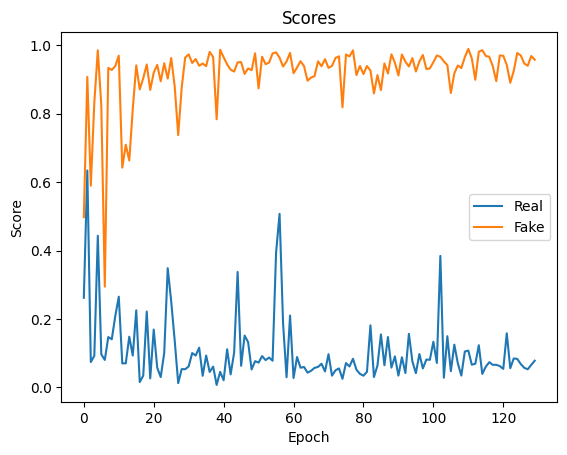

In [37]:


# Plots scores vs. epochs
plt.plot(disc_scores, '-')
plt.plot(gen_scores, '-')
plt.xlabel('Epoch')
plt.ylabel('Score')
plt.legend(['Real', 'Fake'])
plt.title('Scores');



In [ ]:
test_batch = torch.randn(256, seed_size,1,1 ,device=device)

fake_pokemon = generator(test_batch)
# Make the filename for the output
fake_file = "test.png"
save_image(denorm(fake_pokemon), os.path.join(RESULTS_DIR, fake_file), nrow=8)